В блоке кода ниже нужно загрузить файл, чтобы в дальнейшем считать с него информацию. Формат файла: **csv**. Также файл должен быть заполнен по образцу из файла "Шаблон с макросами", значения времени единого формата, фактические значения разделены с дробной частью ".", в csv файле значения разделены "," . После запуска блока кода нужно выбрать нужный файл с компьютера и дождаться загрузки.

Перед запуском блока кода читайте комментарии к нему, они могут быть написаны перед блоком кода либо выделены цветом. С символом "#" в начале комментарии выделены зеленым цветом, с символами """(3 подряд идущих ") красным цветом

Важно запустить последовательно все блоки кода

Графики на бледно-голубом фоне можно сохранить, наведя мышкой на график. В правом верхнем углу появится панель управления, нажав на фотоаппарат можно сохранить в формате "png"

Как сохранять графики на белом фоне описано в комментариях к блокам кода, они сохраняются в google colab автоматически

In [ ]:
import os
import json
from google.colab import files 
files.upload()
os.listdir()

Saving TR-761a.csv to TR-761a (2).csv


MessageError: ignored

Следующий блок кода запускает необходимые библиотеки

In [ ]:
import numpy as np
import pandas as pd
from datetime import datetime,time
import plotly.express as px
import plotly.graph_objects as go
import pylab
import statsmodels.api as sm
import scipy.stats as st
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
from scipy.ndimage import gaussian_filter
import warnings
from copy import deepcopy
import time
warnings.filterwarnings("ignore")

Далее считывается информация с файла и создается датафрейм для работы с данными. Удаляются пустые значения, которые являются выбросами. Также датафрейм делится на части, если есть разные уставки, и происходит анализ всех полученных датафреймов.

In [ ]:
def append_data(datas, dataframe, start, index):
  data = deepcopy(dataframe.iloc[start:index])
  data = data.dropna(subset=  ['Фактическое значение'])
  data.index = np.arange(len(data))
  datas.append(data)

def make_datas(dataframe):
  datas = []
  start = 0
  for row in dataframe[np.isnan(dataframe['Фактическое значение'])].itertuples():
    index = row[0]
    append_data(datas, dataframe, start, index)
    start = index + 1
  append_data(datas, dataframe, start, len(dataframe))
  return datas

In [ ]:
dataframe = pd.read_csv('TR-761a.csv')#здесь нужно заполнить название загруженного файла csv в read_csv
#в строке ниже можно менять формат входных данных в format, d - день, m - месяц, Y - год, H,M,S - часы, минуты, секунды. Нужно писать символы с учетом регистра.
#Пример: входная дата: 21/10/2014 08:00:05. format = "%d/%m/%Y %H:%M:%S"
dataframe['Дата-Время'] = pd.to_datetime(dataframe['Дата-Время'], format = "%d.%m.%Y %H:%M:%S")
datas = make_datas(dataframe)
dataframe = dataframe.dropna(subset= ['Фактическое значение'])
dataframe.index = np.arange(len(dataframe))
dataframes = []
for data in datas:
  for i in range (0,data['Технологическое ограничение'].nunique()):
    dataframes.append(data[data['Технологическое ограничение'] == 
                                data['Технологическое ограничение'].unique()[i]])
    dataframes[i].index = np.arange(len(dataframes[i]))

В блоке кода ниже обозначаем технологические ограничения, предельные значения среднеквадратичных отклонений и средних значений выборок нормальных распределений, которые понадобятся в дальнейшем.

In [ ]:
crit_value = []
std_limit = []
mean_limit = []
for data in dataframes:
  crit_value.append(data['Технологическое ограничение'][0])
  if data['Фактическое значение'].std() < 10:
    std_limit.append(0.5)
  else:
    std_limit.append(data['Фактическое значение'].std()/10)
  if data['Фактическое значение'].std() < 10:
    mean_limit.append(5)
  else:
    mean_limit.append(data['Фактическое значение'].std()/2)

**Построение графика значений до работы СУУТП, строится для каждой уставки**

Как сохранить графики описано в самом верхнем текстовом блоке

In [ ]:
def figure_maker(dataframes_elem, crit_value):
  fig = go.Figure()
  data_lower = dataframes_elem[dataframes_elem['Фактическое значение'] <= crit_value]
  fig.add_trace(go.Scatter(x = dataframes_elem['Дата-Время'],y = dataframes_elem['Фактическое значение'], line = dict(color = 'red'),
                          name = 'до СУУТП выше ограничения'))
  fig.add_trace(go.Scatter(x = dataframes_elem[dataframes_elem['Фактическое значение'] <= crit_value]['Дата-Время'],
                          y = dataframes_elem[dataframes_elem['Фактическое значение'] <= crit_value]['Фактическое значение'], 
                          line = dict(color = 'green'),name = 'до СУУТП'))
  fig.add_trace(go.Scatter(y = dataframes_elem['Технологическое ограничение'], x = dataframes_elem['Дата-Время'], mode = 'lines', 
                          name = 'Технологическое ограничение',line = dict(color = 'orange')))
  fig.update_layout(title = 'Зависимоть фактических значений от времени для данных {}'.format(i+1), xaxis_title = "Время",
                    yaxis_title = 'Значение переменной')
  fig.show()

In [ ]:
for i in range (0,len(dataframes)):
  figure_maker(dataframes[i], crit_value[i])

**Далее значения разделяются на участки с нормальным распределением и на участки значительных отклонений по амплитуде**

In [ ]:
values_list = []
for data in dataframes:
  values_list.append(data['Фактическое значение'].to_numpy())

Функция ниже проверяет, можно ли распределение участка считать нормальным

In [ ]:
def is_normal(data,i):
  big_len = 2000
  mid_len = 1000
  ret = False
  stat, p = st.normaltest(data)
  if len(data) >= big_len:
    alpha = 0
  elif len(data) in set(range(mid_len,big_len)):
    alpha = 0.01
  elif len(data) < mid_len:
    alpha = 0.1
  if (p > alpha) and (data.std() <= values_list[i].std()):
    ret = True
  return ret

Функция ниже проверяет, является ли данная точка концом 'плохого' участка 

In [ ]:
def end_bad(start,i):
  if len(values_list[i]) >= 10000:
    div_value = 500
  elif (len(values_list[i]) < 10000) and (len(values_list[i]) >= 2000):
    div_value = 200
  elif len(values_list[i]) < 2000:
    div_value = 15
  bad_data = values_list[i][start:start + int(len(values_list[i])//div_value)]
  bad_mean = bad_data.mean()
  bad_std = bad_data.std()
  mean = values_list[i].mean()
  if (bad_std <= std_limit[i]) and (bad_mean > mean - mean_limit[i]) and (bad_mean < mean + mean_limit[i]):
    return True
  else:
    return False

Функция ниже отделяет участок переходного процесса для датафреймов с новой уставкой

In [ ]:
def transition_process(data):
  if data[0] < data.mean():
    for i in range(0,len(data)):
      if data[i] >= data.mean():
        return data[:i], i
  else:
    for i in range(0,len(data)):
      if data[i] <= data.mean():
        return data[:i], i

Функция ниже возвращает участок указанной длины(процент длины исходного датафрейма), начиная с заданной строки. Нужна для сокращения кода.

In [ ]:
def iloc(data,start_num, i):
  return data[start_num:start_num + int(len(data)//(i/100))]

Функция ниже возвращает участок с отклонением по амплитуде

In [ ]:
def bad_sample_maker(data, start_num, i,k):
  for j in range(1,i+1):
    if start_num + int(len(data)//(i/100 - j/100)) >= len(data):
      return data[start_num + int(len(data)//(i/100)):], len(data)
    if (end_bad(start_num + int(len(data)//(i/100 - j/100)),k)):
      return data[start_num + int(len(data)//(i/100)):start_num + int(len(data)//(i/100 - j/100))], start_num + int(len(data)//(i/100 - j/100))

В этом блоке происходит разделение на выборки и формирование массивов хороших и плохих выборок для каждого датафрейма, выборка - класс с порядковым номером в датафрейме и значениями

In [ ]:
class sample(object):
  def __init__(self,values,index):
    self.values = values
    self.index = index

In [ ]:
def separating_cycle(start_num,values_list_elem, start_i, bad_samples,samples, samples_list,bad_samples_list, index):
  while (start_num < len(values_list_elem)):
    for i in range (start_i,50001):
      data = iloc(values_list_elem,start_num,i)
      #если выборка маленькая и не нашлось участка с нормальным распределением - определяем ее как плохую
      if len(data) < 8 or i == 50000:
        bad_samples.append(sample(data,index))
        start_num += int(len(values_list_elem)//(i/100))
        index += 1
        if start_num >= len(values_list_elem):
          samples_list.append(samples)
          bad_samples_list.append(bad_samples)
        break
      #проверка распределения на нормальное
      if is_normal(data,k):
        samples.append(sample(data,index))
        index += 1
        #если проверка пройдена - ищем плохую выборку после конца хорошей
        if start_num + int(len(values_list_elem)//(i/100)) < len(values_list_elem):
          bad_data, new_start_num = bad_sample_maker(values_list_elem, start_num, i,k)
          bad_samples.append(sample(bad_data,index))
          start_num = new_start_num
          index += 1
          if start_num >= len(values_list_elem):
            samples_list.append(samples)
            bad_samples_list.append(bad_samples)
            break
        else:
          start_num = len(values_list_elem)
          samples_list.append(samples)
          bad_samples_list.append(bad_samples)
        break
    if start_num < len(values_list_elem):
      start_i = 100*len(values_list_elem)//(len(values_list_elem) - start_num)
    if start_i > 50000:
      bad_samples.append(sample(values_list_elem[start_num:], index))
      index += 1
      start_num = len(values_list_elem)
      samples_list.append(samples)
      bad_samples_list.append(bad_samples)
    print("Подождите немного, идет разделение выборок, прошло секунд: {}".format(time.time() - start_time))
  return samples_list, bad_samples_list, index

In [ ]:
start_time = time.time()
samples_list = []
bad_samples_list = []
index = 1
for k in range(0, len(values_list)):
  bad_samples = []
  samples = []
  start_num = 0
  start_i = 100
  if k != 0:
    tr_data, new_start = transition_process(values_list[k])
    bad_samples.append(sample(tr_data, index))
    index += 1
    start_num = new_start
    if start_num >= len(values_list[k]):
      samples_list.append(samples)
      bad_samples_list.append(bad_samples)
      break 
  samples_list, bad_samples_list, index = separating_cycle(start_num,values_list[k], start_i, bad_samples,samples, samples_list,bad_samples_list, index)
print("Все готово! Прошло секунд: {}".format(time.time() - start_time))

Подождите немного, идет разделение выборок, прошло секунд: 0.9820461273193359
Подождите немного, идет разделение выборок, прошло секунд: 1.4788157939910889
Подождите немного, идет разделение выборок, прошло секунд: 4.208358526229858
Подождите немного, идет разделение выборок, прошло секунд: 4.211759328842163
Все готово! Прошло секунд: 4.211976051330566


In [ ]:
for bad_samples in bad_samples_list:
  i = 0
  while i < len(bad_samples):
    if len(bad_samples[i].values) == 0:
      del bad_samples[i]
      continue
    i += 1

In [ ]:
def return_dataframe(bad_sample,i):
  index_array = dataframes[i][dataframes[i]['Фактическое значение'] == bad_sample[0]].index.values
  start = index_array[0]
  for index in index_array:
    if dataframes[i].iloc[index:index + len(bad_sample)]['Фактическое значение'].to_list() == list(bad_sample):
      start = index  
  end = start + len(bad_sample)
  data = dataframes[i].iloc[start:end]
  return data

**На этом разделение на выборки закончено, далее идет анализ**

Далее строим графики "плохих" выборок

Следует обратить внимание на то, что некоторые "плохие" выборки состоят из малого кол-ва точек, это может свидетельствовать о смене "хороших" выборок, т.е. изменении среднего значения или среднекв. отклонения, в конечный отчет стоит включить графики, где наиболее наглядно видно отклонение начальных данных от регламентного режима и конечное сглаживание 

In [ ]:
for i in range (0,len(bad_samples_list)):
  if len(bad_samples_list[i]) > 0:
    for j in range (0,len(bad_samples_list[i])):
      fig = go.Figure()
      fig.add_trace(go.Scatter(x = return_dataframe(bad_samples_list[i][j].values,i)['Дата-Время'],y = bad_samples_list[i][j].values, 
                               line = dict(color = 'blue'), name = 'Фактические значения'))
      fig.add_trace(go.Scatter(x = return_dataframe(bad_samples_list[i][j].values,i)['Дата-Время'],
                               y = return_dataframe(bad_samples_list[i][j].values,i)['Технологическое ограничение'], 
                               line = dict(color = 'red'), name = 'Технологическое ограничение'))
      fig.update_layout(title = 'Для данных {} участок {}'.format(i+1,j+1))
      fig.show()
  elif len(bad_samples_list[i]) == 0:
    print('Нет участков с отклонениями, все выборки соответствуют нормальным для данных {}'.format(i+1))

## QQ plot 
График сходства распределения нашей выборки и нормального распределения до уменьшения среднекв. отклонения, чтобы убедиться, что наши распр-я близки к нормальным и применять статистические методы 

Если точки лежат на одной прямой(примерно), то распределение можно считать нормальным

Как сохранить графики в "png" описано в комментариях ниже

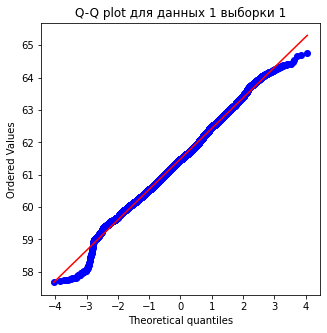

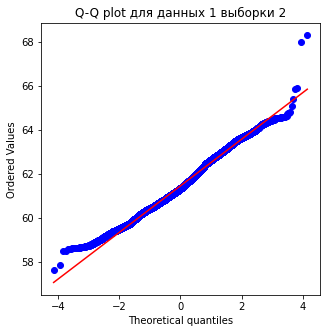

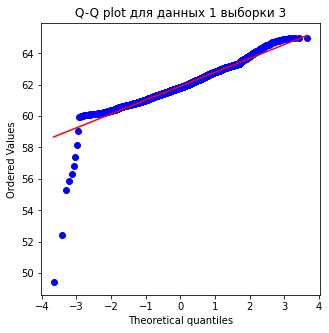

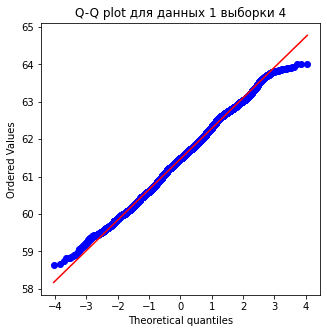

In [ ]:
for i in range(0,len(samples_list)):
  for j in range (0,len(samples_list[i])):
    fig, ax = plt.subplots(figsize = (5,5))#здесь можно изменить размер фигуры в аргументах figsize
    st.probplot(samples_list[i][j].values, dist='norm', plot=ax)
    ax.set_title("Q-Q plot для данных {} выборки {}".format(i+1,j+1))#можно поменять титульник графиков в кавычках
    fig.show()
    #строка ниже сохраняет каждый график в формате 'png', графики слева, нужно нажать на значок папки, графики в sample_data
    #если навести на название графика в sample_data появятся три точки, нажав на них и выбрав download можно скачать файл
    fig.savefig("Q-Q plot {}-{}".format(i+1,j+1))#можно менять название файлов 'png' для графиков

Теперь уменьшим среднеквадратичное отклонение на 50% благодаря СУУТП, сформируем новые выборки с уменьшенным показателем среднеквадратичного отклонения и посмотрим на гистограммы и графики распределения до и после внедрения СУУТП

Функция ниже возвращает фактические значения, их средние и среднекв. отклонения для определенной выборки после уменьшения отклонения

In [ ]:
def after(samples,x,s_values_before,reduction):
  s_values_after = np.array(s_values_before)*(1-reduction/100)
  samples_after = []
  for sample_objs in samples:
    values = np.zeros(len(sample_objs.values))
    index = deepcopy(sample_objs.index)
    sample_after = sample(values,index)
    samples_after.append(sample_after)
  for i in range (0,len(samples)):
    for j in range (0, len(samples[i].values)):
      samples_after[i].values[j] = samples[i].values[j] - (samples[i].values[j] - x[i])*(reduction/100)
  return samples_after,s_values_after

В блоке кода ниже все значения выборок 'раскладываются по полочкам'

In [ ]:
samples_reduced_list = []
s_values_after_list = []
s_values_before_list = []
x_values = []
samples_list_deepcopy = deepcopy(samples_list)
for samples in samples_list_deepcopy:

  #заполняем массивы средних значений и среднекв. отклонений выборок
  x = []
  s_values_before = []
  for sample_objs in samples:
    x.append(sample_objs.values.mean())
    s_values_before.append(sample_objs.values.std())
  x_values.append(x)
  s_values_before_list.append(s_values_before)

  #массивы переменных после изменений
  reduction = 50 #здесь можно задать процент, на который вы хотите сократить среднекв. отклонение, например, если на 30%, то reduction = 30
  samples_after,s_values_after = after(samples,x,s_values_before,reduction)
  samples_reduced_list.append(samples_after)
  s_values_after_list.append(s_values_after)


Перейдем к построению гистограмм

Функция ниже строит одну гистограмму, в ней можно изменять: **размер легенды графика, ширину линии нормального распределения**

In [ ]:
def plots(ax,sample_objs,X,S,sample_objs_name,alpha,color,color_line):
  temp_sample_objs = deepcopy(sample_objs)
  temp_sample_objs.sort()
  """в строчку кода ниже можно добавить аргумент bins после аргумента alpha, он отвечает за разбиение гистограммы на столбы
  Если вводить число, то чем больше bins, тем больше столбов. Также есть различные режимы.
  Подробнее: https://numpy.org/doc/stable/reference/generated/numpy.histogram_bin_edges.html#numpy.histogram_bin_edges
  https://matplotlib.org/3.3.0/api/_as_gen/matplotlib.pyplot.hist.html"""
  
  ax.hist(temp_sample_objs, density=True,alpha = alpha,color = color,label = 'Гистограмма ' + sample_objs_name)

  #на строчке ниже в markersize можно изменить ширину линии
  ax.plot(temp_sample_objs, st.norm.pdf(temp_sample_objs, X, S),'-o',color = color_line,markersize=3, label = 'Нормальное распределение ' + sample_objs_name)

  #на строчке ниже в fontsize можно изменить размер легенды
  ax.legend(fontsize = 10)

Функция ниже строит строит гистограммы до и после СУУТП, в ней можно изменять: **цвет гистограмм, прозрачность**

In [ ]:
def plots_maker(ax, sample_objs_before,sample_objs_after, X,S_before,S_after):
  #на строчке ниже в аргументе после названия "после СУУТП" можно изменить прозрачность(число, чем меньше тем прозрачнее)
  #предпоследний аргумент - цвет гистограммы после СУУТП, последний - цвет линии норм. распределения после СУУТП
  plots(ax,sample_objs_after,X,S_after,'после СУУТП',1,"#1328ad","#09134f") 
  #на строчке ниже в аргументе после названия "до СУУТП" можно изменить прозрачность(число, чем меньше тем прозрачнее)
  #предпоследний аргумент - цвет гистограммы до СУУТП, последний - цвет линии норм. распределения после СУУТП
  plots(ax,sample_objs_before,X,S_before,'до СУУТП',0.75,"#e82020","#941515") 

Ниже строятся графики и сохраняются

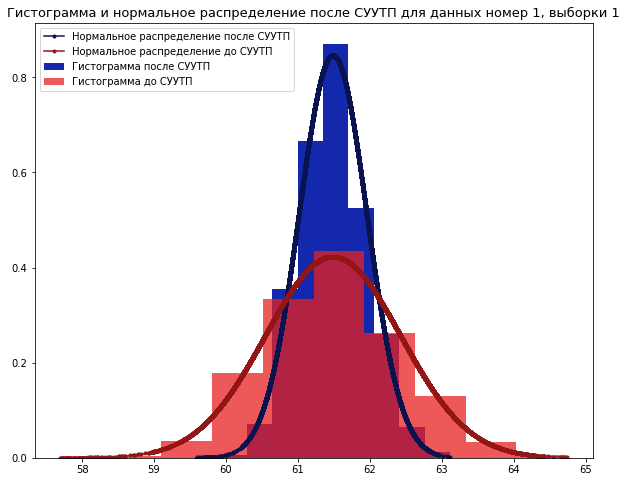

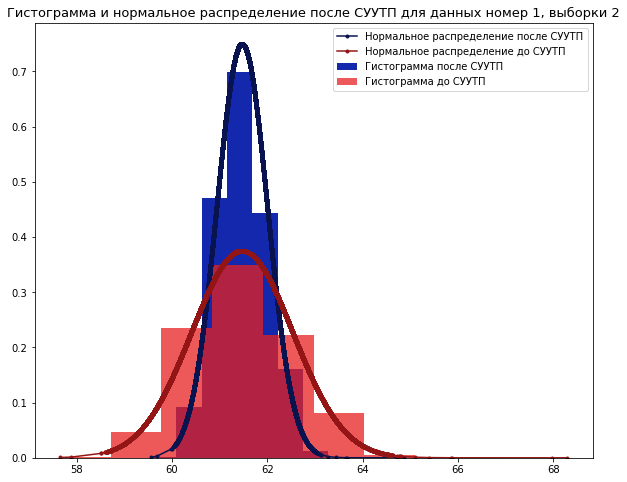

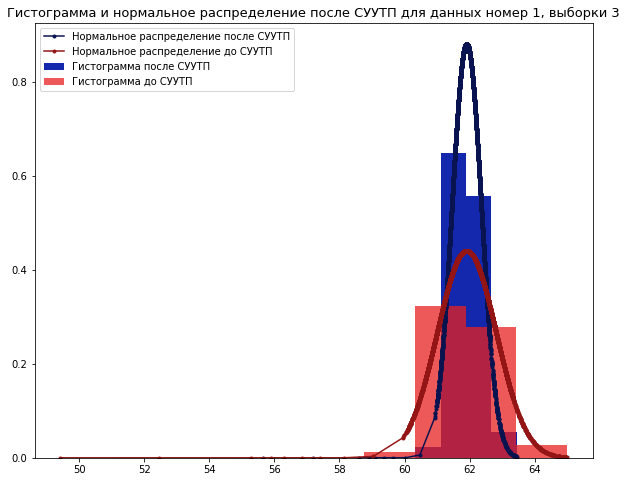

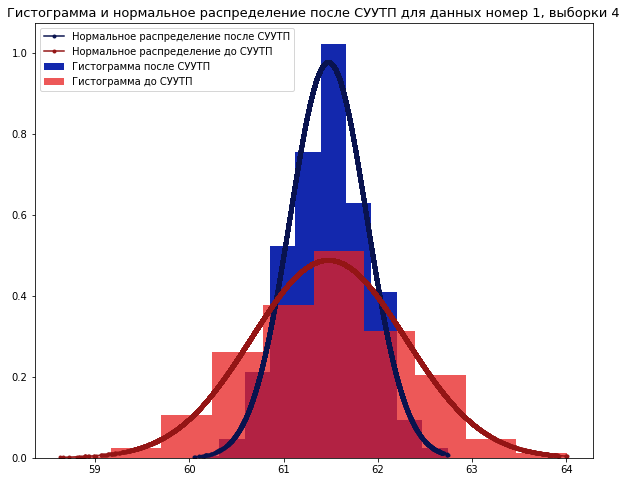

In [ ]:
for i in range(0,len(samples_reduced_list)):
  for j in range (0, len(samples_reduced_list[i])):
    fig, ax = plt.subplots(figsize = (10,8))#здесь можно настроить размер фигур в figsize
    plots_maker(ax, samples_list[i][j].values,samples_reduced_list[i][j].values, 
            x_values[i][j], s_values_before_list[i][j], s_values_after_list[i][j])
    #строчкой ниже можно изменить название титульника и размер в size
    ax.set_title('Гистограмма и нормальное распределение после СУУТП для данных номер {}, выборки {}'.format(i+1,j+1), size = 13)
    #строка ниже сохраняет каждый график в формате 'png', графики слева, нужно нажать на значок папки, графики в sample_data
    #если навести на название графика в sample_data появятся три точки, нажав на них и выбрав download можно скачать файл
    fig.savefig('гистограмма и нормальное распределение {}-{}'.format(i+1,j+1))#можно изменить название файла

Далее пропускаем полученные значения через фильтр для сглаживания кривой

In [ ]:
#здесь можно изменить sigma-значение фильтра, его суть - чем больше sigma, тем больше сглаживание кривой
#главное не злоупотреблять, иначе модель будет нереалистична. Оптимум: до 10
sigma = 5
bad_samples_after_list = []
bad_samples_list_deepcopy = deepcopy(bad_samples_list)
for bad_samples in bad_samples_list_deepcopy:
  bad_samples_after = []
  for bad_sample in bad_samples:
    bad_samples_after.append(sample(bad_sample.values,bad_sample.index))
  for i in range (0,len(bad_samples)):
    bad_samples_after[i].values = gaussian_filter(bad_samples_after[i].values, sigma = sigma)
  bad_samples_after_list.append(bad_samples_after)
samples_after_list = deepcopy(samples_reduced_list)
for i in range (0,len(samples_after_list)):
  for j in range (0,len(samples_after_list[i])):
    samples_after_list[i][j].values = gaussian_filter(samples_after_list[i][j].values, sigma = sigma)

**После проделанных преобразований можно подвинуть полученные значения ближе к технологическому ограничению, чтобы продемонстрировать заказчику возможное увеличение диапазона значений**

Ниже сформируем массивы разниц, на которые можно увеличить диапазон для каждого датафрейма

In [ ]:
maxes_list = []
deltas_list = []
margine = 2 #здесь можно менять запас величины(на сколько максимальное значение выборок с нормальным распределением будет меньше технологического ограничения)
for i in range (0,len(samples_after_list)):
  maxes = []
  for j in range(0,len(samples_after_list[i])):
    max = samples_after_list[i][j].values.max()
    maxes.append(max)
  maxes = np.array(maxes)
  max_general = maxes.max()
  delta = crit_value[i] - max_general - margine
  maxes_list.append(max_general)
  deltas_list.append(delta)

Блоки кода ниже формируют датафрейм из данных после СУУТП

In [ ]:
def normal_sample_approximate(samples, delta):
  for k in range (0,len(samples.values)):
    samples.values[k] += delta
  return samples

In [ ]:
def bad_sample_approximate(values, crit_value_elem, delta, margine):
  for k in range (0,len(values)):
    if values[k] >= crit_value_elem:
      values[k] = crit_value_elem
    else:
      if crit_value_elem - margine < values[k] + delta:
        values[k] = crit_value_elem - margine
      else:
        values[k] += delta
  return values

In [ ]:
samples_after_apc = []
new_x_values = []

#аппроксимирует хорошие выборки
samples_list_approximate = deepcopy(samples_after_list)
for i in range (0,len(samples_list_approximate)):
  new_x = []
  for j in range (0,len(samples_list_approximate[i])):
    samples_list_approximate[i][j] = normal_sample_approximate(samples_list_approximate[i][j], deltas_list[i])
    new_x.append(samples_list_approximate[i][j].values.mean())
    samples_after_apc.append(samples_list_approximate[i][j])
  new_x_values.append(new_x)

#аппроксимирует плохие выборки
bad_samples_list_approximate = deepcopy(bad_samples_after_list)
for i in range (0, len(bad_samples_list_approximate)):
  for j in range (0,len(bad_samples_list_approximate[i])):
    if i != 0 and j == 0:
        prev = 0
        for m in range(0,len(samples_after_apc)):
          if samples_after_apc[m].index > bad_samples_list_approximate[i][0].index:
            prev = m - 1
            break
        diff = samples_after_apc[prev].values[-1] - bad_samples_list_approximate[i][0].values[0]
        bad_samples_list_approximate[i][0].values += diff
        samples_after_apc.append(bad_samples_list_approximate[i][0])
        continue
    bad_samples_list_approximate[i][j].values = bad_sample_approximate(bad_samples_list_approximate[i][j].values, crit_value[i], deltas_list[i], margine)
    samples_after_apc.append(bad_samples_list_approximate[i][j])

Среднее значениее линии тренда после внедрения СУУТП

In [ ]:
np.array(new_x_values[0]).mean()

76.1991236113905

Среднее значение линии тренда до внедрения СУУТП

In [ ]:
np.array(x_values[0]).mean()

61.581714990637515

## **Предельное значение, на которое можно поднять линию тренда**

In [ ]:
np.array(new_x_values[0]).mean() - np.array(x_values[0]).mean()

14.61740862075299

In [ ]:
samples_after_apc.sort(key = lambda elem: elem.index)
values_after_apc = []
for sample_objs in samples_after_apc:
  for value in sample_objs.values:
    values_after_apc.append(value)
values_after_apc = gaussian_filter(values_after_apc,sigma = 5)

График до/после СУУТП

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = dataframe['Дата-Время'],y = values_after_apc,line = dict(color = 'blue'),name = 'после СУУТП'))
fig.add_trace(go.Scatter(x = dataframe['Дата-Время'],y = dataframe['Фактическое значение'], line = dict(color = 'green'),
                          name = 'до СУУТП'))
fig.add_trace(go.Scatter(y = dataframe['Технологическое ограничение'], x = dataframe['Дата-Время'], line = dict(color = 'orange'), name = 'Технологическое ограничение'))
fig.show()

Графики "плохих" выборок до и после

In [ ]:
for i in range (0, len(bad_samples_list_approximate)):
  for j in range (0,len(bad_samples_list_approximate[i])):
    fig = go.Figure()
    values = gaussian_filter(bad_samples_list_approximate[i][j].values, sigma = 5)
    fig.add_trace(go.Scatter(x = return_dataframe(bad_samples_list[i][j].values,i)['Дата-Время'], y = values,
                             line = dict(color = "blue"), name = "После СУУТП"))
    fig.add_trace(go.Scatter(x = return_dataframe(bad_samples_list[i][j].values,i)['Дата-Время'],y = bad_samples_list[i][j].values, 
                               line = dict(color = 'red'), name = 'До СУУТП'))
    fig.add_trace(go.Scatter(x = return_dataframe(bad_samples_list[i][j].values,i)['Дата-Время'],
                               y = return_dataframe(bad_samples_list[i][j].values,i)['Технологическое ограничение'], 
                               line = dict(color = 'orange'), name = 'Технологическое ограничение'))
    fig.show()